In [69]:
"""
코드 작성자 : DevTae (김태현)

아래 코드는 XAI 를 활용하여 투자 성향에 대한 종목 분석, 투자자에게 맞는 방향성을 제공하여 투자 습관을 개선시켜주는 솔루션의 내용을 다루고 있습니다.
특히, LIME(Local Interpretable Model-agnostic Explanation) 에 대한 기술을 주로 사용하였으며, 이를 활용하여 투자자의 현 실태를 파악할 수 있도록 합니다.
"""

'\n코드 작성자 : DevTae (김태현)\n\n아래 코드는 XAI 를 활용하여 투자 성향에 대한 종목 분석, 투자자에게 맞는 방향성을 제공하여 투자 습관을 개선시켜주는 솔루션의 내용을 다루고 있습니다.\n특히, LIME(Local Interpretable Model-agnostic Explanation) 에 대한 기술을 주로 사용하였으며, 이를 활용하여 투자자의 현 실태를 파악할 수 있도록 합니다.\n'

In [1]:
import pandas as pd
import os
import warnings
warnings.filterwarnings('ignore')

In [2]:
import matplotlib.pyplot as plt
import matplotlib.font_manager as fm
fe = fm.FontEntry(
    fname=r'./NanumGothic.ttf', # ttf 파일이 저장되어 있는 경로
    name='NanumGothic')                        # 이 폰트의 원하는 이름 설정
fm.fontManager.ttflist.insert(0, fe)              # Matplotlib에 폰트 추가
plt.rcParams.update({'font.family': 'NanumGothic'}) # 폰트 설정
plt.rcParams.update({'axes.unicode_minus': False }) # Minus Unicode False

f = [f.name for f in fm.fontManager.ttflist if 'Nanum' in f.name]
f

['NanumGothic',
 'NanumSquare_ac',
 'NanumSquareOTF_ac',
 'NanumSquare',
 'NanumSquareOTF_ac',
 'NanumSquareOTF_ac',
 'NanumSquareOTF_ac',
 'NanumSquare_ac',
 'NanumSquare_ac',
 'NanumSquare',
 'NanumSquareOTF',
 'NanumSquareOTF',
 'NanumSquare_ac',
 'NanumSquareOTF',
 'NanumSquare',
 'NanumSquareOTF',
 'NanumSquareOTF',
 'NanumSquareOTF_ac',
 'NanumSquare']

In [3]:
# 2020~2023 총 4개년치에 대한 데이터를 바탕으로 분석 및 모델링 진행

finance_datas = pd.read_csv('data/data_preprocessing_unified_including_others_and_percentile.csv', sep=',', encoding='utf-8', dtype={'종목코드':str, '분기':int})

finance_datas

,종목코드,년도,분기,배당금지급,유동자산,유동부채,영업이익(손실),수익(매출액),당기순이익(손실),자본총계,...,avg_of_변동성지표_percentile,avg_of_수익성지표_percentile,avg_of_안정성지표_percentile,avg_of_가치성지표_percentile,avg_of_모멘텀지표_percentile,변동성지표_percentile,수익성지표_percentile,안정성지표_percentile,가치성지표_percentile,모멘텀지표_percentile
0,000020,2020.0,1,3.312928e+09,2.379160e+11,5.601470e+10,2.706892e+09,6.700367e+10,2.259000e+09,2.994870e+11,...,0.533622,0.415920,0.228631,0.435595,0.039450,0.533622,0.285415,0.228631,0.424985,0.039450
1,000950,2020.0,1,0.000000e+00,4.445098e+10,2.139210e+11,-3.642227e+09,2.840698e+10,-7.534318e+09,1.237910e+11,...,0.617155,0.119396,0.930663,0.093545,0.041094,0.617155,0.016139,0.930663,0.054991,0.041094
2,001540,2020.0,1,0.000000e+00,1.473480e+11,5.060352e+10,2.657248e+09,3.777548e+10,2.329921e+09,1.491430e+11,...,0.720114,0.279289,0.410341,0.543036,0.049163,0.720114,0.092947,0.410341,0.559325,0.049163
3,001790,2020.0,1,6.212995e+09,5.346720e+11,4.020430e+11,7.324572e+09,2.836740e+11,1.456410e+08,4.575730e+11,...,0.477286,0.591452,0.844292,0.104453,0.154961,0.477286,0.686940,0.844292,0.062762,0.154961
4,002230,2020.0,1,0.000000e+00,9.711871e+10,2.172407e+10,-3.697193e+08,1.134262e+10,-2.315460e+09,1.336150e+11,...,0.684250,0.045776,0.160191,0.436491,0.014644,0.684250,0.003288,0.160191,0.427376,0.014644
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3341,383220,2023.0,3,6.102839e+10,7.170640e+11,4.755630e+11,1.485240e+11,4.928150e+11,1.190810e+11,1.221050e+12,...,0.505081,0.643853,0.440227,0.908398,0.498057,0.505081,0.811417,0.440227,0.937537,0.498057
3342,405100,2023.0,3,5.737761e+09,7.099587e+10,8.948139e+09,1.729899e+09,1.500569e+10,1.754362e+09,1.018220e+11,...,0.663628,0.545029,0.257322,0.823819,0.611327,0.663628,0.572475,0.257322,0.864913,0.611327
3343,425040,2023.0,3,4.249243e+09,1.721390e+11,6.219917e+10,3.685606e+09,2.418480e+10,4.575588e+09,1.681180e+11,...,0.786312,0.451783,0.404662,0.922445,0.052451,0.786312,0.351166,0.404662,0.948147,0.052451
3344,900070,2023.0,3,4.103465e+06,5.672710e+08,1.290003e+08,9.139425e+06,1.489769e+08,4.868978e+06,6.494237e+08,...,0.533622,0.247061,0.265690,0.996115,0.176330,0.533622,0.069038,0.265690,0.996115,0.176330


In [4]:
from sklearn.linear_model import LinearRegression
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler
import numpy as np
import math

import lime
import lime.lime_tabular
#pip install lime

import random
random.seed(777)

def train_model(X, y, feature_names, class_names):
    # 데이터를 훈련 세트와 테스트 세트로 나눔
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    
    # 회귀 모델 생성
    #model = LinearRegression()
    #model = SVR(kernel='rbf')
    model = RandomForestRegressor(n_estimators=12, random_state=42)
    
    # 모델 훈련
    model.fit(X_train, y_train)
    
    # LIME 설명 인스턴스 생성
    explainer = lime.lime_tabular.LimeTabularExplainer(X_train, 
                                                       feature_names=feature_names, 
                                                       class_names=class_names,
                                                       mode="regression", 
                                                       discretize_continuous=True,
                                                       discretizer='quartile')
    
    # 테스트 데이터로 예측
    y_pred = model.predict(X_test)
    
    # 성능 평가 (평균 제곱 오차)
    mse = mean_squared_error(y_test, y_pred)
    
    return model, explainer, mse

In [5]:
"""
1. 변동성지표 (Slow vs Fast) - 클수록 Fast
 - ATR : ATRPP (Average True Range Per Price)

2. 수익성지표 (Poor vs Rich) - 클수록 Rich
 - 배당수익률
 - 순이익률 (Net Profit Margin)
 - 자본회전율 (Asset Turnover)
 
3. 안정성지표 (Safety vs Danger) - 클수록 Danger
 - Altman Z Score (사용 X)
   - Z > 2.99 : 안정적 상태
   - 1.81 < Z < 2.99 : 주의 요망
   - Z < 1.81 : 파산 가능성이 높음
 - 부채비율 

4. 가치성지표 (Hidden vs Popular) - 클수록 Popular
 - PER (시가총액 / 순이익) (사용 X)
 - PSR (시가총액 / 매출)
 - PBR (시가총액 / 순자산)

5. 모멘텀지표 (Weak vs Strong) - 클수록 Strong
 - TSF Slope : TSF (Time Series Forcasting) 지표에   Slope (기울기) 계산 (Percentage 방식)
"""

required_models = { "변동성지표" : [ "ATR" ],
                    "수익성지표" : [ "배당수익률", "자본회전율", "순이익률" ],
                    "안정성지표" : [ "부채비율" ],
                    "가치성지표" : [ "log(PBR)", "log(PSR)" ],
                    "모멘텀지표" : [ "TSF_SLOPE" ] }

class_names = { "변동성지표" : [ "Slow", "Fast" ],
                "수익성지표" : [ "Poor", "Rich" ],
                "안정성지표" : [ "Safety", "Danger" ],
                "가치성지표" : [ "Hidden", "Popular" ],
                "모멘텀지표" : [ "Weak", "Strong" ] }

models = {}
explainers = {}
scalers = {}

for key in required_models.keys():    
    X = finance_datas[required_models[key]].values
    
    ss = StandardScaler()
    ss.fit(X)
    X_ss = ss.transform(X)
    
    y = finance_datas[key + "_percentile"].values.reshape(-1, 1)
    
    model, explainer, mse = train_model(X_ss, y, required_models[key], class_names[key])

    models[key] = model
    explainers[key] = explainer
    scalers[key] = ss

    print(f"Trained model using '{key}' column gets the output of mse {round(mse, 4)}, there is approximately a margin of error of around {round(math.sqrt(mse), 2)} for each")
    print(f"Explainer model is here, {explainers[key]}.")
    print()
    
for key in models.keys():
    print(f"{key} is the {models[key]} model, using parameters as like {required_models[key]}")

    # 테스트 세트에서 LIME 설명 생성
    X = finance_datas[required_models[key]].values
    
    X_ss = scalers[key].transform(X)
    X_ss = X_ss[0] # 예제로 첫 번째 데이터를 사용
    
    exp = explainers[key].explain_instance(X_ss, models[key].predict, num_features=len(required_models[key]))
    
    # 설명 시각화
    exp.show_in_notebook()
    
    print()

Trained model using '변동성지표' column gets the output of mse 0.0, there is approximately a margin of error of around 0.0 for each
Explainer model is here, <lime.lime_tabular.LimeTabularExplainer object at 0x000001F8F222E130>.

Trained model using '수익성지표' column gets the output of mse 0.0008, there is approximately a margin of error of around 0.03 for each
Explainer model is here, <lime.lime_tabular.LimeTabularExplainer object at 0x000001F8F5965FA0>.

Trained model using '안정성지표' column gets the output of mse 0.0, there is approximately a margin of error of around 0.0 for each
Explainer model is here, <lime.lime_tabular.LimeTabularExplainer object at 0x000001F8F315B4C0>.

Trained model using '가치성지표' column gets the output of mse 0.0001, there is approximately a margin of error of around 0.01 for each
Explainer model is here, <lime.lime_tabular.LimeTabularExplainer object at 0x000001F8F598FA60>.

Trained model using '모멘텀지표' column gets the output of mse 0.0, there is approximately a margin o


수익성지표 is the RandomForestRegressor(n_estimators=12, random_state=42) model, using parameters as like ['배당수익률', '자본회전율', '순이익률']



안정성지표 is the RandomForestRegressor(n_estimators=12, random_state=42) model, using parameters as like ['부채비율']



가치성지표 is the RandomForestRegressor(n_estimators=12, random_state=42) model, using parameters as like ['log(PBR)', 'log(PSR)']



모멘텀지표 is the RandomForestRegressor(n_estimators=12, random_state=42) model, using parameters as like ['TSF_SLOPE']


In [6]:
"""
주석 작성자 : DevTae (김태현)

XAI 성능 평가의 기준에 있어서 어떤 식으로 접근할 것인가?
--> 1. 투자 성향 개선이 되는데에 있어서 어떻게 해야 하며 얼마나 효과적인가?, 
    2. 적은 설명력의 모델이 큰 설명력의 모델의 성능을 따라잡을 수 있을 것인가?

+) 전제조건 : 투자자에게 하나의 방향성만을 제시한다. 한 지표에 대하여 최적의 방향성을 제시해야 한다. (--> User Scenario)

<1> - 투자 성향에 대한 방향성 제시 아이디어 및 개선 여부 검증
희망하는 투자 성향을 설정한다. ex) { "변동성지표" : 0.5, 
                                     "수익성지표" : 0.2, 
                                     "안정성지표" : 0.4, 
                                     "가치성지표" : 0.7,
                                     "모멘텀지표" : 0.1 }

그 이후, Root Mean Square 를 바탕으로 오차에 대한 정보를 수집한다.

(알고리즘 적용) 설명력이 가장 높은 feature 에 대하여 수치를 조정한다. (quartile 로 설정하여, 그 다음 boundary 에 해당되는 수치로 변경 시도 / 갭 크기만큼 조정)

변경된 X 데이터를 바탕으로 RMS 를 계산해본 뒤 이전과의 RMS 와 비교하여 개선 유무를 판단한다.


<2> - 설명 모델의 구성에 따른 설명력과 간결성의 관계
상관관계가 가장 높은 셀에 대해서 내림차순으로 정렬한 것이다.
--> 가치성지표, 변동성지표, 수익성지표, 안정성지표, 모멘텀지표

가설 : 상관관계(피쳐 누적합)가 낮은 지표를 위주로 구성하는 것이 설명 모델의 성능을 유지하되, 설명의 간결성을 높일 수 있는 방안이라고 생각된다.
(모든 피쳐 값들에 대해서는 있는 것이 맞다. 당장에 사용하지 않는 것임.)

변동성지표_percentile    1.944966
가치성지표_percentile    1.886510
수익성지표_percentile    1.745459
안정성지표_percentile    1.454072
모멘텀지표_percentile    1.346935

전체 지표에 대한 설명 모델을 구축한 뒤, 상관관계가 높은 순으로 1개, 2개, 3개, 4개에 대한 설명 모델과 낮은 순으로 1개, 2개, 3개, 4개에 대한 설명 모델 적용의 검증 결과를 보여줄 것.

"""

'\n주석 작성자 : DevTae (김태현)\n\nXAI 성능 평가의 기준에 있어서 어떤 식으로 접근할 것인가?\n--> 1. 투자 성향 개선이 되는데에 있어서 어떻게 해야 하며 얼마나 효과적인가?, \n    2. 적은 설명력의 모델이 큰 설명력의 모델의 성능을 따라잡을 수 있을 것인가?\n\n+) 전제조건 : 투자자에게 하나의 방향성만을 제시한다. 한 지표에 대하여 최적의 방향성을 제시해야 한다. (--> User Scenario)\n\n<1> - 투자 성향에 대한 방향성 제시 아이디어 및 개선 여부 검증\n희망하는 투자 성향을 설정한다. ex) { "변동성지표" : 0.5, \n                                     "수익성지표" : 0.2, \n                                     "안정성지표" : 0.4, \n                                     "가치성지표" : 0.7,\n                                     "모멘텀지표" : 0.1 }\n\n그 이후, Root Mean Square 를 바탕으로 오차에 대한 정보를 수집한다.\n\n(알고리즘 적용) 설명력이 가장 높은 feature 에 대하여 수치를 조정한다. (quartile 로 설정하여, 그 다음 boundary 에 해당되는 수치로 변경 시도 / 갭 크기만큼 조정)\n\n변경된 X 데이터를 바탕으로 RMS 를 계산해본 뒤 이전과의 RMS 와 비교하여 개선 유무를 판단한다.\n\n\n<2> - 설명 모델의 구성에 따른 설명력과 간결성의 관계\n상관관계가 가장 높은 셀에 대해서 내림차순으로 정렬한 것이다.\n--> 가치성지표, 변동성지표, 수익성지표, 안정성지표, 모멘텀지표\n\n가설 : 상관관계(피쳐 누적합)가 낮은 지표를 위주로 구성하는 것이 설명 모델의 성능을 유지하되, 설명의 간결성을 높일 수 있는 방안이라고 생각된다.\n(모든 피쳐 값들에 대해서는 있는 것이 맞다. 당장에 사용하지

In [7]:
"""
코드 작성자 : DevTae (김태현)

아래 코드는 희망 투자 성향과 특정 종목에 대한 분석 결과를 보여줍니다.
"""

'\n코드 작성자 : DevTae (김태현)\n\n아래 코드는 희망 투자 성향과 특정 종목에 대한 분석 결과를 보여줍니다.\n'

In [8]:
# LIME 결과값 가져오기 시도
key = "수익성지표"

X = finance_datas[required_models[key]].values    
X_ss = scalers[key].transform(X)
X_ss = X_ss[20]

explanation = explainers[key].explain_instance(X_ss, models[key].predict, num_features=len(required_models[key]))
explanation.show_in_notebook()

min_value = explanation.min_value 
max_value = explanation.max_value
print(min_value, max_value)

predicted_value = explanation.predicted_value
print(predicted_value)

explanation_list = explanation.as_list()
print(explanation_list)

explanation_discretizer = explainers[key].discretizer.names[0]
print(explanation_discretizer)
gap = float(explanation_discretizer[1].split(' ')[-1]) - float(explanation_discretizer[1].split(' ')[0])
print(gap)

0.0033871289101413994 0.9986800159394301
0.291940625622634
[('순이익률 <= -0.04', -0.3215579853836805), ('배당수익률 > 0.33', 0.28868421847443504), ('-0.50 < 자본회전율 <= -0.33', -0.11058430368250596)]
['배당수익률 <= -0.68', '-0.68 < 배당수익률 <= -0.28', '-0.28 < 배당수익률 <= 0.33', '배당수익률 > 0.33']
0.4


In [9]:
# Feature 들에 대한 Mean Squared Error 에 대한 함수 정의
def mean_squared_error_(actual, predicted):
    # 예측 값과 실제 값이 저장된 키를 사용하여 오차 계산
    squared_errors = [(predicted[key] - actual[key]) ** 2 for key in actual]
    # 모든 오차 값의 평균 계산
    mse = sum(squared_errors) / len(squared_errors)
    return mse

In [10]:
# explanation 에서의 오차 계산을 위한 함수 정의
def get_euclidean_distance(actual, predicted):
    return abs(actual - predicted)

In [11]:
# 특정 (각) explanation 에서 주어진 percentile 에 해당하는 value 값을 가져옴
def get_target_feature_value(explanation: lime.explanation.Explanation, 
                             percentile: float):
    min_value = explanation.min_value
    max_value = explanation.max_value
    
    return min_value + (max_value - min_value) * percentile

In [12]:
# 특정 (각) explanation 에서의 가장 설명력 높은 입력값에 대하여 다음 혹은 이전 구간 방향으로 갭 크기만큼 조정하는 함수
def get_recommended_X_ss(explainer: lime.lime_tabular.LimeTabularExplainer,
                         explanation: lime.explanation.Explanation,
                         feature_list: list,
                         target_feature_value: float,
                         is_print: bool,
                         mode: str,
                         bins: int
                        ):
    explanation_list = explanation.as_list()
    
    # 기존 X_ss 불러오기
    X_ss = [ x[1] for x in explanation_list ]
    
    # 설명력 높거나 작은 feature_name 알아내기
    if "HighestExplainAbility" in mode:
        index = 0
    elif "LowestExplainAbility" in mode:
        index = -1

    try:
        _ = float(explanation_list[index][0].split(' ')[0])
        feature_name = explanation_list[index][0].split(' ')[2]
    except:
        feature_name = explanation_list[index][0].split(' ')[0]
    
    # 설명력 기준 피쳐 값 index 찾기
    selected_index = feature_list.index(feature_name)
    
    # 구간 분석하기 - 갭 계산
    explanation_discretizer = explainer.discretizer.names[selected_index] # 가장 설명력 높은 피쳐 값
    highest_explanation_feature_lowest = float(explanation_discretizer[1].split(' ')[0])
    highest_explanation_feature_gap = float(explanation_discretizer[1].split(' ')[-1]) - float(explanation_discretizer[1].split(' ')[0])
    highest_explanation_feature_total = highest_explanation_feature_gap * 4
    
    # predicted_value 에 따라 설명력 높은 피쳐 값 조정하기
    predicted_value = explanation.predicted_value
    min_value = explanation.min_value
    max_value = explanation.max_value
    
    if predicted_value >= target_feature_value:
        X_ss[selected_index] = X_ss[selected_index] - highest_explanation_feature_total * abs((predicted_value - target_feature_value) / (max_value - min_value)) * (4 / bins)
    else:
        X_ss[selected_index] = X_ss[selected_index] + highest_explanation_feature_total * abs((predicted_value - target_feature_value) / (max_value - min_value)) * (4 / bins)
        
    if is_print:
        print(f"[변경사항] {feature_list[selected_index]} 지표를 {highest_explanation_feature_gap} (in XAI LIME Gap) 만큼 조정하였습니다.")
        
    return X_ss

In [13]:
"""
1. 변동성지표 (Slow vs Fast) - 클수록 Fast
2. 수익성지표 (Poor vs Rich) - 클수록 Rich
3. 안정성지표 (Safety vs Danger) - 클수록 Danger
4. 가치성지표 (Hidden vs Popular) - 클수록 Popular
5. 모멘텀지표 (Weak vs Strong) - 클수록 Strong
"""

# 희망 투자 성향과 특정 종목의 특징을 바탕으로 한 Root Mean Square 계산
def get_features(explainers: dict, # list of lime.lime_tabular.LimeTabularExplainer
                 models: dict, # list of LinearRegression
                 required_models: dict, # list of LinearRegression Features
                 target_percentile: dict, # 목표치에 대한 백분위 수치 제공
                 using_explanation_features: list, # 선택한 feature 에 대해서만 조정을 진행함
                 X_ss: dict, # list of X_ss
                 is_print: bool,
                 mode: str, # all : 전부 변경, one : 하나만 변경
                 bins: int # 구간 몇 개로 나눌 지 정하는 옵션
                ): 
    target_feature = {}
    stock_feature = {}
    feedback_feature = {}
    explanations = {}
    
    distances = {} # 가장 큰 오차에 대한 Feature 포착 및 조정 진행
    
    # feature 계산
    for key in explainers.keys():
        explanation = explainers[key].explain_instance(X_ss[key], models[key].predict, num_features=len(required_models[key]))
        explanations[key] = explanation
        
        # target_feature 계산
        value = get_target_feature_value(explanations[key], target_percentile[key])
        target_feature[key] = value
        
        # stock_feature 계산
        value = explanations[key].predicted_value
        stock_feature[key] = value
        
        # 우선, feedback_feature 에 stock_feature 와 동일하게 입력
        feedback_feature[key] = value
        
        # 각 Feature 에 대한 distance 계산
        distances[key] = get_euclidean_distance(target_feature[key], stock_feature[key])
        
        if is_print:
            explanations[key].show_in_notebook()
    
    # using_explanation_features 인 동시에, 가장 설명력이 높은 카테고리 지표에 대하여 조정 작업을 진행함
    # feedback_feature 계산
    sorted_distances = dict(sorted(distances.items(), key=lambda item: item[1], reverse=True))
    selected_keys = list()
    
    for key in sorted_distances.keys():
        if key not in using_explanation_features:
            continue
        selected_keys.append(key)
        
    if "AdjustAllFeature" in mode:
        for key in selected_keys:
            X_ss_feedback = get_recommended_X_ss(explainers[key], explanations[key], required_models[key], target_feature[key], is_print, mode, bins)
            explanation_feedback = explainers[key].explain_instance(np.array(X_ss_feedback), models[key].predict, num_features=len(required_models[key]))
            explanations[key] = explanation_feedback
            value = explanations[key].predicted_value
            feedback_feature[key] = value
            if is_print:
                print(f"[변경사항] {key} 에 대한 explanation 을 재정의하였습니다.")
                explanations[key].show_in_notebook()
        
    elif "AdjustOneFeature" in mode:
        X_ss_feedback = get_recommended_X_ss(explainers[selected_keys[0]], explanations[selected_keys[0]], required_models[selected_keys[0]], target_feature[selected_keys[0]], is_print, mode, bins)
        explanation_feedback = explainers[selected_keys[0]].explain_instance(np.array(X_ss_feedback), models[selected_keys[0]].predict, num_features=len(required_models[selected_keys[0]]))
        explanations[selected_keys[0]] = explanation_feedback
        value = explanations[selected_keys[0]].predicted_value
        feedback_feature[selected_keys[0]] = value
        
        if is_print:
            print(f"[변경사항] {selected_keys[0]} 에 대한 explanation 을 재정의하였습니다.")
            explanations[selected_keys[0]].show_in_notebook()
    
    else:
        raise Exception("지원하지 않는 mode 입니다.")
        
    return target_feature, stock_feature, feedback_feature

In [14]:
def get_overview_between_target_and_stock(explainers: dict, 
                                          models: dict,
                                          required_models: dict,
                                          target_percentile: dict,
                                          using_explanation_features: list,
                                          X_ss: np.ndarray,
                                          is_print: bool,
                                          mode: str,
                                          bins: int):
    
    # 희망 투자 성향에 대한 특정 종목 성향 Root Mean Square 계산 진행
    target_feature, stock_feature, feedback_feature = get_features(explainers, 
                                                                   models, 
                                                                   required_models, 
                                                                   target_percentile, 
                                                                   using_explanation_features, 
                                                                   X_ss,
                                                                   is_print,
                                                                   mode,
                                                                   bins)
    
    if is_print:
        print("[출력] 각 feature 에 대한 분석을 진행합니다.")
        
        # 희망 투자 성향 분석 결과 출력
        # 딕셔너리 키와 값 분리
        labels = list(target_feature.keys())
        values = list(target_feature.values())
        
        # 막대그래프 플로팅
        plt.figure(figsize=(9, 4))
        plt.bar(labels, values)
        
        # 그래프 제목과 축 제목 추가
        plt.title('희망 투자 성향 분석')
        plt.ylabel('수치')
        
        # 그래프 보이기
        plt.show()
        
        # 종목 성향 분석 결과 출력
        # 딕셔너리 키와 값 분리
        labels = list(stock_feature.keys())
        values = list(stock_feature.values())
        
        # 막대그래프 플로팅
        plt.figure(figsize=(9, 4))
        plt.bar(labels, values)
        
        # 그래프 제목과 축 제목 추가
        plt.title('종목에 대한 성향 분석')
        plt.ylabel('수치')
        
        # 그래프 보이기
        plt.show()
        
        # 피드백 결과 출력
        # 딕셔너리 키와 값 분리
        labels = list(feedback_feature.keys())
        values = list(feedback_feature.values())
        
        # 막대그래프 플로팅
        plt.figure(figsize=(9, 4))
        plt.bar(labels, values)
        
        # 그래프 제목과 축 제목 추가
        plt.title('피드백 결과에 대한 성향 분석')
        plt.ylabel('수치')
        
        # 그래프 보이기
        plt.show()
    
    return mean_squared_error_(target_feature, stock_feature), mean_squared_error_(target_feature, feedback_feature)

[변경사항] TSF_SLOPE 지표를 0.37 (in XAI LIME Gap) 만큼 조정하였습니다.
[변경사항] 모멘텀지표 에 대한 explanation 을 재정의하였습니다.


[변경사항] 부채비율 지표를 0.25 (in XAI LIME Gap) 만큼 조정하였습니다.
[변경사항] 안정성지표 에 대한 explanation 을 재정의하였습니다.


[변경사항] 순이익률 지표를 0.02 (in XAI LIME Gap) 만큼 조정하였습니다.
[변경사항] 수익성지표 에 대한 explanation 을 재정의하였습니다.


[변경사항] log(PBR) 지표를 0.59 (in XAI LIME Gap) 만큼 조정하였습니다.
[변경사항] 가치성지표 에 대한 explanation 을 재정의하였습니다.


[변경사항] ATR 지표를 0.5599999999999999 (in XAI LIME Gap) 만큼 조정하였습니다.
[변경사항] 변동성지표 에 대한 explanation 을 재정의하였습니다.


[출력] 각 feature 에 대한 분석을 진행합니다.


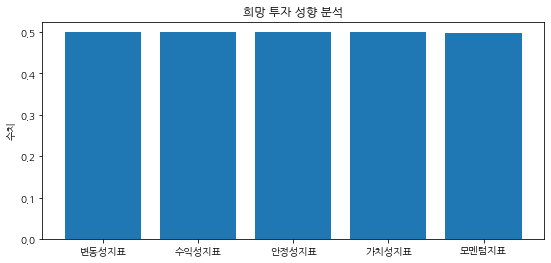

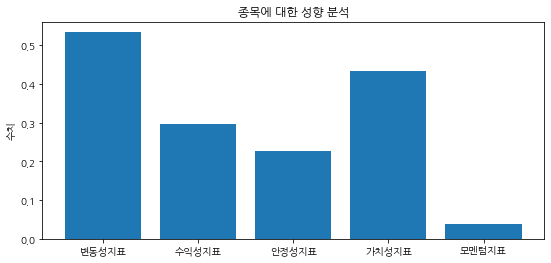

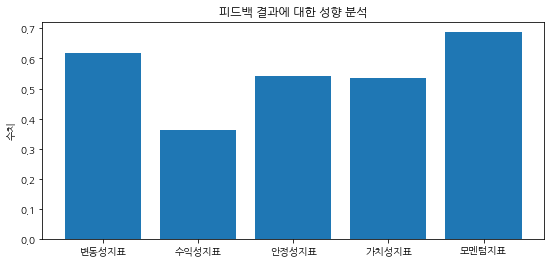

[Result]  0.06616771699835405 0.014373301529774608


In [15]:
# 희망 투자 성향
target_percentile = { "변동성지표" : 0.5, 
                      "수익성지표" : 0.5, 
                      "안정성지표" : 0.5, 
                      "가치성지표" : 0.5,
                      "모멘텀지표" : 0.5 }

# 선택한 종목 index
stock_index = 0

# 특정 종목 성향 분석
total_X_ss = {}
    
for key in models.keys():
    X = finance_datas[required_models[key]].values
    X_ss = scalers[key].transform(X)   
    X_ss = X_ss[stock_index]
    
    total_X_ss[key] = X_ss

# 투자 성향 overview 확인
using_explanation_features = [ "변동성지표", "수익성지표", "안정성지표", "가치성지표", "모멘텀지표" ]
stock_feature_mse, feedback_feature_mse = get_overview_between_target_and_stock(explainers, models, required_models, target_percentile, using_explanation_features, total_X_ss, True, "AdjustAllFeature|LowestExplainAbility", 4)

print("[Result] ", stock_feature_mse, feedback_feature_mse)


In [97]:
# 희망 투자 성향
target_percentile = { "변동성지표" : 0.5, 
                      "수익성지표" : 0.5, 
                      "안정성지표" : 0.5, 
                      "가치성지표" : 0.5,
                      "모멘텀지표" : 0.5 }

# 상관관계 분포에 따른 피쳐의 중요도를 보여줌
list_of_using_explanation_features = [ [ "변동성지표", "수익성지표", "안정성지표", "가치성지표", "모멘텀지표" ],
                                       [ "변동성지표", "가치성지표", "수익성지표", "안정성지표" ],
                                       [ "가치성지표", "수익성지표", "안정성지표", "모멘텀지표" ],
                                       [ "변동성지표", "가치성지표", "수익성지표" ],
                                       [ "수익성지표", "안정성지표", "모멘텀지표" ],
                                       [ "변동성지표", "가치성지표" ],
                                       [ "안정성지표", "모멘텀지표" ],
                                       [ "변동성지표" ],
                                       [ "모멘텀지표" ]]

# i) 하나 바꾸는 것과 전부 바꾸는 것을 비교하여 바꾸는 것에 대한 효과를 보여줌
# ii) 설명력 높은 Feature 를 바꾸는 것과 설명력 낮은 Feature 를 바꾸는 것 사이의 중요도를 보여줌
list_of_mode = [ "AdjustAllFeature|HighestExplainAbility",
                 "AdjustAllFeature|LowestExplainAbility",
                 "AdjustOneFeature|HighestExplainAbility",
                 "AdjustOneFeature|LowestExplainAbility" ]

# bins 에 따른 변화도 분석
#list_of_bins = [ 2, 4, 8, 16, 32, 64, 128 ] # bins 에 따른 분포 --> 실험에서 제외
list_of_bins = [ 4 ]

"""
<데이터 plot>
높은 상관계수 순서 "변동성지표"
낮은 상관계수 순서 "모멘텀지표"
모든변수조정 "AdjustAllFeature"
변수하나조정 "AdjustOneFeature"
설명력높은것 "HighestExplainAbility"
설명력낮은것 "LowestExplainAbility"
"""
high_corr_all_highest_x = []
high_corr_all_highest_y = []

high_corr_all_lowest_x = []
high_corr_all_lowest_y = []

high_corr_one_highest_x = []
high_corr_one_highest_y = []

high_corr_one_lowest_x = []
high_corr_one_lowest_y = []

low_corr_all_highest_x = []
low_corr_all_highest_y = []

low_corr_all_lowest_x = []
low_corr_all_lowest_y = []

low_corr_one_highest_x = []
low_corr_one_highest_y = []

low_corr_one_lowest_x = []
low_corr_one_lowest_y = []

"""
<샘플 설정>
95% 신뢰수준 - 59개 샘플 필요 (Ln(0.05)/Ln(0.95)
99% 신뢰수준 - 299개 샘플 필요 (Ln(0.05)/Ln(0.99)
"""
# 1, 59, 299
samples = 59
sampled_indices = random.sample(range(len(finance_datas[required_models[key]].values)), samples)

    
for using_explanation_features in list_of_using_explanation_features:
    for mode in list_of_mode:
        for bins in list_of_bins:
            print(using_explanation_features, ",", mode, ",", bins)
            
            total_stock_feature_mse = 0
            total_feedback_feature_mse = 0
            
            for stock_index in sampled_indices:
                
                # 특정 종목 성향 분석
                total_X_ss = {}
        
                for key in models.keys():
                    X = finance_datas[required_models[key]].values
                    X_ss = scalers[key].transform(X)   
                    X_ss = X_ss[stock_index]
        
                    total_X_ss[key] = X_ss
    
                # 투자 성향 overview 확인
                stock_feature_mse, feedback_feature_mse = get_overview_between_target_and_stock(explainers, models, required_models, target_percentile, using_explanation_features, total_X_ss, False, mode, bins)

                total_stock_feature_mse += stock_feature_mse
                total_feedback_feature_mse += feedback_feature_mse
                
            #avg_of_enhanced = (total_stock_feature_mse - total_feedback_feature_mse) / total_stock_feature_mse
            avg_of_enhanced = total_stock_feature_mse - total_feedback_feature_mse
                
            # plot 을 위한 검증 결과 저장
            if using_explanation_features[0] == "변동성지표":
                if "AdjustAllFeature" in mode:
                    if "HighestExplainAbility" in mode:
                        high_corr_all_highest_x.append(len(using_explanation_features))
                        high_corr_all_highest_y.append(avg_of_enhanced)
                        
                    elif "LowestExplainAbility" in mode:
                        high_corr_all_lowest_x.append(len(using_explanation_features))
                        high_corr_all_lowest_y.append(avg_of_enhanced)
                    else:
                        raise Exception("1")
                elif "AdjustOneFeature" in mode:
                    if "HighestExplainAbility" in mode:
                        high_corr_one_highest_x.append(len(using_explanation_features))
                        high_corr_one_highest_y.append(avg_of_enhanced)
                    elif "LowestExplainAbility" in mode:
                        high_corr_one_lowest_x.append(len(using_explanation_features))
                        high_corr_one_lowest_y.append(avg_of_enhanced)
                    else:
                        raise Exception("2")
                else:
                    raise Exception("3")
            if using_explanation_features[-1] == "모멘텀지표":
                if "AdjustAllFeature" in mode:
                    if "HighestExplainAbility" in mode:
                        low_corr_all_highest_x.append(len(using_explanation_features))
                        low_corr_all_highest_y.append(avg_of_enhanced)
                    elif "LowestExplainAbility" in mode:
                        low_corr_all_lowest_x.append(len(using_explanation_features))
                        low_corr_all_lowest_y.append(avg_of_enhanced)
                    else:
                        raise Exception("4")
                elif "AdjustOneFeature" in mode:
                    if "HighestExplainAbility" in mode:
                        low_corr_one_highest_x.append(len(using_explanation_features))
                        low_corr_one_highest_y.append(avg_of_enhanced)
                    elif "LowestExplainAbility" in mode:
                        low_corr_one_lowest_x.append(len(using_explanation_features))
                        low_corr_one_lowest_y.append(avg_of_enhanced)
                    else:
                        raise Execption("5")
                else:
                    raise Exception("6")
            else:
                raise Exception("list_of_using_explanation_features error")
                
            print("[Result]", total_stock_feature_mse, total_feedback_feature_mse)
            print("avg_of_enhanced :", avg_of_enhanced)
            print()
            
# 실행 시간 오래 걸리므로 저장 진행
print("high_corr_all_highest_x =", high_corr_all_highest_x)
print("high_corr_all_highest_y =", high_corr_all_highest_y)

print("high_corr_all_lowest_x =", high_corr_all_lowest_x)
print("high_corr_all_lowest_y =", high_corr_all_lowest_y)

print("high_corr_one_highest_x =", high_corr_one_highest_x)
print("high_corr_one_highest_y =", high_corr_one_highest_y)

print("high_corr_one_lowest_x =", high_corr_one_lowest_x)
print("high_corr_one_lowest_y =", high_corr_one_lowest_y)

print("low_corr_all_highest_x =", low_corr_all_highest_x)
print("low_corr_all_highest_y =", low_corr_all_highest_y)

print("low_corr_all_lowest_x =", low_corr_all_lowest_x)
print("low_corr_all_lowest_y =", low_corr_all_lowest_y)

print("low_corr_one_highest_x =", low_corr_one_highest_x)
print("low_corr_one_highest_y =", low_corr_one_highest_y)

print("low_corr_one_lowest_x =", low_corr_one_lowest_x)
print("low_corr_one_lowest_y =", low_corr_one_lowest_y)

['변동성지표', '수익성지표', '안정성지표', '가치성지표', '모멘텀지표'] , AdjustAllFeature|HighestExplainAbility , 4
[Result] 4.5945572483728885 1.5244199346462692
avg_of_enhanced : 3.0701373137266192

['변동성지표', '수익성지표', '안정성지표', '가치성지표', '모멘텀지표'] , AdjustAllFeature|LowestExplainAbility , 4
[Result] 4.59725051691461 1.485412756859533
avg_of_enhanced : 3.1118377600550766

['변동성지표', '수익성지표', '안정성지표', '가치성지표', '모멘텀지표'] , AdjustOneFeature|HighestExplainAbility , 4
[Result] 4.596231281384898 2.8982831712674995
avg_of_enhanced : 1.6979481101173985

['변동성지표', '수익성지표', '안정성지표', '가치성지표', '모멘텀지표'] , AdjustOneFeature|LowestExplainAbility , 4
[Result] 4.5983515130549355 2.9403607934102256
avg_of_enhanced : 1.65799071964471

['변동성지표', '가치성지표', '수익성지표', '안정성지표'] , AdjustAllFeature|HighestExplainAbility , 4
[Result] 4.594824606442471 2.374333736411617
avg_of_enhanced : 2.2204908700308543

['변동성지표', '가치성지표', '수익성지표', '안정성지표'] , AdjustAllFeature|LowestExplainAbility , 4
[Result] 4.593729747973467 2.4501885936369416
avg_of_enhan

In [16]:
# 연산 시간이 오래 걸리기에 리스트 정보 임시 저장
# 
x = [5, 4, 3, 2, 1]
x = x[:-1]
high_corr_all_highest_y = [3.0701373137266192, 2.2204908700308543, 1.6076300901674756, 1.6874405935344678, 0.7099622058810504]
high_corr_all_highest_y = high_corr_all_highest_y[:-1]
high_corr_all_lowest_y = [3.1118377600550766, 2.1435411543365253, 1.5715504184132696, 1.685774437938783, 0.7096451524404515]
high_corr_all_lowest_y = high_corr_all_lowest_y[:-1]
high_corr_one_highest_y = [1.6979481101173985, 1.4850159444109883, 1.3088767100427314, 1.273414486329962, 0.7136029223638349]
high_corr_one_highest_y = high_corr_one_highest_y[:-1]
high_corr_one_lowest_y = [1.65799071964471, 1.4873393698895887, 1.2892798401080379, 1.2716669209678062, 0.7052864583302325]
high_corr_one_lowest_y = high_corr_one_lowest_y[:-1]
low_corr_all_highest_y = [3.0701373137266192, 2.4098312692960713, 1.3699030682497462, 1.4689627156643366, 0.8824164185633334]
low_corr_all_highest_y = low_corr_all_highest_y[:-1]
low_corr_all_lowest_y = [3.1118377600550766, 2.4463538552256163, 1.4313975966032695, 1.4640549939357244, 0.8817596007692692]
low_corr_all_lowest_y = low_corr_all_lowest_y[:-1]
low_corr_one_highest_y = [1.6979481101173985, 1.606197081290094, 1.356584850054352, 1.24950788694657, 0.8809084488147572]
low_corr_one_highest_y = low_corr_one_highest_y[:-1]
low_corr_one_lowest_y = [1.65799071964471, 1.6022380417838682, 1.2789328902432149, 1.249150259020455, 0.8808140054791171]
low_corr_one_lowest_y = low_corr_one_lowest_y[:-1]

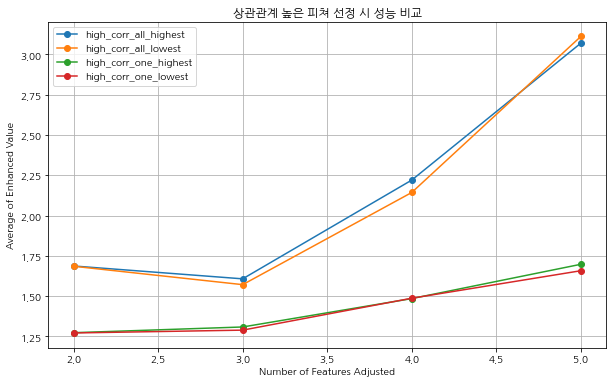

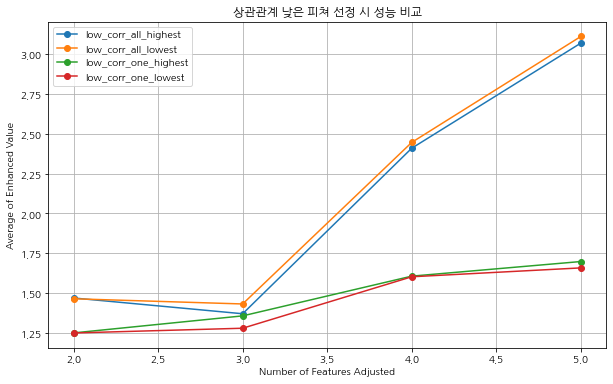

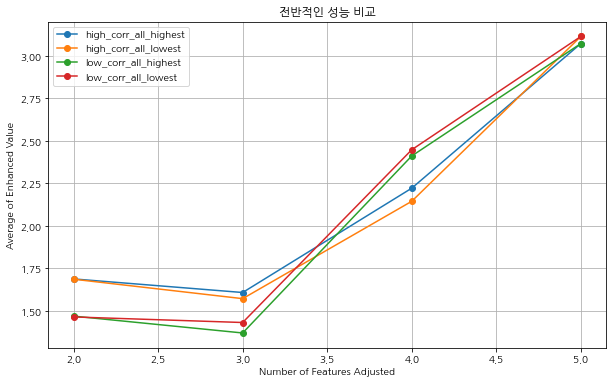

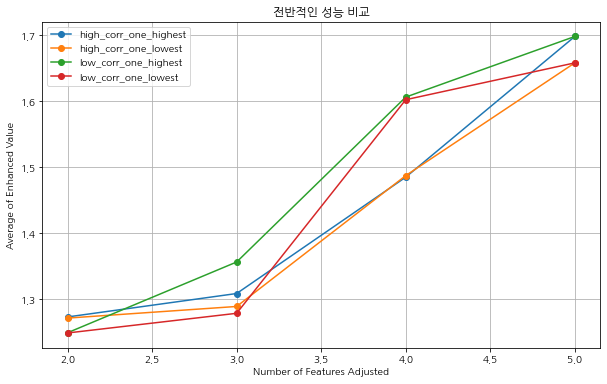

In [18]:
plt.figure(figsize=(10, 6))
plt.plot(x, high_corr_all_highest_y, marker='o', label='high_corr_all_highest')
plt.plot(x, high_corr_all_lowest_y, marker='o', label='high_corr_all_lowest')
plt.plot(x, high_corr_one_highest_y, marker='o', label='high_corr_one_highest')
plt.plot(x, high_corr_one_lowest_y, marker='o', label='high_corr_one_lowest')
plt.title('상관관계 높은 피쳐 선정 시 성능 비교')
plt.xlabel('Number of Features Adjusted')
plt.ylabel('Average of Enhanced Value')
plt.legend()
plt.grid(True)
plt.show()

plt.figure(figsize=(10, 6))
plt.plot(x, low_corr_all_highest_y, marker='o', label='low_corr_all_highest')
plt.plot(x, low_corr_all_lowest_y, marker='o', label='low_corr_all_lowest')
plt.plot(x, low_corr_one_highest_y, marker='o', label='low_corr_one_highest')
plt.plot(x, low_corr_one_lowest_y, marker='o', label='low_corr_one_lowest')
plt.title('상관관계 낮은 피쳐 선정 시 성능 비교')
plt.xlabel('Number of Features Adjusted')
plt.ylabel('Average of Enhanced Value')
plt.legend()
plt.grid(True)
plt.show()

plt.figure(figsize=(10, 6))
plt.plot(x, high_corr_all_highest_y, marker='o', label='high_corr_all_highest')
plt.plot(x, high_corr_all_lowest_y, marker='o', label='high_corr_all_lowest')
plt.plot(x, low_corr_all_highest_y, marker='o', label='low_corr_all_highest')
plt.plot(x, low_corr_all_lowest_y, marker='o', label='low_corr_all_lowest')
plt.title('전반적인 성능 비교')
plt.xlabel('Number of Features Adjusted')
plt.ylabel('Average of Enhanced Value')
plt.legend()
plt.grid(True)
plt.show()


plt.figure(figsize=(10, 6))
plt.plot(x, high_corr_one_highest_y, marker='o', label='high_corr_one_highest')
plt.plot(x, high_corr_one_lowest_y, marker='o', label='high_corr_one_lowest')
plt.plot(x, low_corr_one_highest_y, marker='o', label='low_corr_one_highest')
plt.plot(x, low_corr_one_lowest_y, marker='o', label='low_corr_one_lowest')
plt.title('전반적인 성능 비교')
plt.xlabel('Number of Features Adjusted')
plt.ylabel('Average of Enhanced Value')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
"""
작성자 : DevTae (김태현)

AdjustAllFeature 과 AdjustOneFeature 사이에는 전부 다 수정하기 때문에 전자가 더 향상폭이 크다는 것을 볼 수 있음. (당연한 결과)
HighestExplainAbility 와 LowestExplainAbility 의 경우에는, HighestExplainAbility 의 경우가 향상폭이 더 높았음.
오히려, list_of_using_explanation_features 에 대하여 확인해봤을 때, 예상과 달리 상관관계가 높은 feature 로 구성한 것이 아닌 것에 비해 성능 향상이 두드러졌다.

대략적으로 여기서 볼 수 있는 점이, avg_enhanced_ratio 에 대해서만, 
① 전반적으로 AdjustOneFeature 는 0보다 크고, AdjustOneFeature 보다 AdjustAllFeature 가 성능이 더 좋다.
 --> XAI 모델을 통한 개선에 대한 검증 가능, 
② 설명력이 높은 피쳐(HighestExplainAbility) 위주로 개선 시도하는 것이 설명력이 낮은 피쳐(LowestExplainAbility)보다 성능이 뛰어남, 
 --> 설명력이 높고 낮음으로 개선을 시도하기보다는 
③ 사용 지표(ex. ['변동성지표', '수익성지표', '안정성지표', '가치성지표', '모멘텀지표'])에 대한 avg_enhanced_ratio 추이를 통해, 
  상관관계 높은 것으로 구성하는 것이 더 효율적임을 발견. 사용 지표를 줄여야 하는 순간이 온다면 상관계수를 높이는 방식으로 접근 가능.
"""